In [1]:
import os

import cv2
import numpy as np
import makiflow as mf
from tensorflow.contrib.image import rotate
import matplotlib.pyplot as plt
import seaborn as sns
from glob import glob

from makiflow.augmentation.segmentation.balancing.hc_scanner import HCScanner
from makiflow.augmentation.segmentation.augment_ops import AffineAugment, ElasticAugment, FlipAugment, RotateAugment
from makiflow.augmentation.segmentation.data_provider import Data 
from makiflow.augmentation.segmentation.image_mask_cutter import ImageCutter

In [2]:
%matplotlib inline

In [73]:
def get_data(data_path, batch_num=1, images_prefix='images', mask_prefix='masks'):
    path_to_data = data_path
    Xtrain = []
    Ytrain = []
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    images_names = glob(f'{path_to_data}/{images_prefix}/img*.bmp')
    for image_name in images_names:
        try:
            mask_name = image_name.replace(images_prefix, mask_prefix)
            mask_name = mask_name.replace('img', 'mask')
            image = cv2.imread(image_name)
            mask = cv2.imread(mask_name, cv2.IMREAD_GRAYSCALE)
            assert(image.shape[:2] == mask.shape[:2])
            
#             for i in range(0, 3):
#                 image[..., i] = clahe.apply(image[..., i])
            image = cv2.resize(image, (1024, 1024), interpolation=cv2.INTER_LINEAR)
            mask = cv2.resize(mask, (1024, 1024), interpolation=cv2.INTER_NEAREST) // 255
            
            Xtrain.append(image)
            Ytrain.append(mask)
        except Exception as e:
            print(e)
            print(f'Error with: {image_name}, {mask_name}')
        
    return Xtrain, Ytrain

In [59]:
Xtrain, Ytrain = get_data('/raid/rustam/med_data/BinarySegmentation/k-fold/7-fold/train_set')

In [60]:
data = Data(Xtrain, Ytrain)
data = FlipAugment([FlipAugment.FLIP_HORIZONTALLY, FlipAugment.FLIP_VERTICALLY, FlipAugment.FLIP_HV])(data)
data = ElasticAugment(alpha=500, noise_invert_scale=11, std=20, border_mode='reflect_101', num_maps=7)(data)
# data = ElasticAugment(alpha=700, noise_invert_scale=7, std=11, border_mode='reflect_101', num_maps=20)(data)
aXtrain, aYtrain = data.get_data()

len(aXtrain), len(aYtrain)

(2112, 2112)

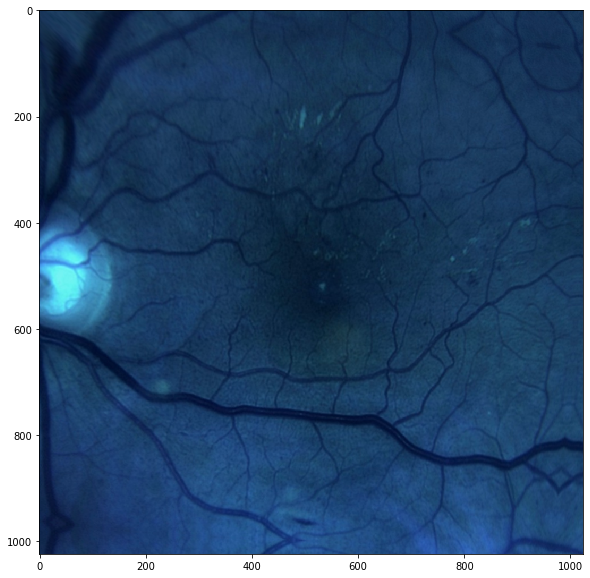

In [61]:
plt.figure(figsize=(10, 10))
plt.imshow(aXtrain[2])

In [62]:
path = '/raid/rustam/med_data/BinarySegmentation/k-fold/7-fold/aug_set'
img_path = f'{path}/images'
mask_path = f'{path}/masks'
os.makedirs(img_path, exist_ok=True)
os.makedirs(mask_path, exist_ok=True)
for index, (image, mask) in enumerate(zip(aXtrain, aYtrain)):
    cv2.imwrite(f'{img_path}/{index}.bmp', image)
    cv2.imwrite(f'{mask_path}/{index}.bmp', mask)    

In [6]:
Xtest, Ytest = get_data('/raid/rustam/med_data/BinarySegmentation/test_data')

In [7]:
mf.set_main_gpu(1)

In [8]:
import makiflow as mf
from makiflow.save_recover import Builder

In [9]:
model = Builder.segmentator_from_json('../Models/x65/xception_v17_binary.json')
model.set_session(mf.get_low_memory_sess())
model.load_weights('Test#2_Fine_tuning/l2=1e-5_adam_lr=1e-6_loss=CE_batch=2/x-65/MakiSegmentator_gamma=2_opt_name=adam1_bsz=2/last_weights/weights.ckpt')



Model is restored!



INFO:tensorflow:Restoring parameters from Test#2_Fine_tuning/l2=1e-5_adam_lr=1e-6_loss=CE_batch=2/x-65/MakiSegmentator_gamma=2_opt_name=adam1_bsz=2/last_weights/weights.ckpt
Weights are loaded.


In [13]:
preds = []
for i in range(0, 8, 2):
    p = model.predict(np.array(Xtrain[i:i+2]) / 255.)
    preds += list(p)

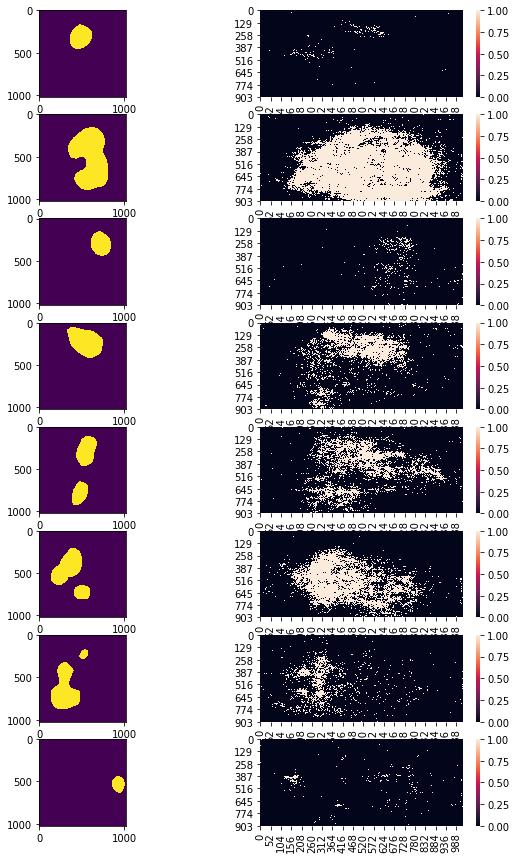

In [ ]:
sns.heatmap(np.argmax(p, axis=2))

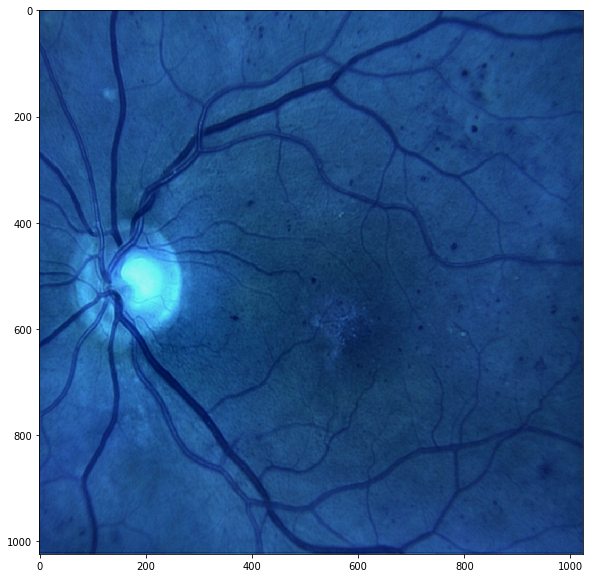

In [12]:
plt.figure(figsize=(10, 10))
plt.imshow(Xtest[0])

In [7]:
node = model.get_node('predictions')
tensors = node.get_previous_tensors()

In [21]:
lnames = []
for i, x in enumerate(tensors):
    lnames.append(tensors[x].get_parent_layer().get_name())

In [22]:
tensors['Input'].get_parent_layer()

<mf.base.MakiTensor 'name=Input' shape=[2, 1024, 1024, 3] dtype=float32>

In [21]:
from shutil import copyfile
from copy import copy

In [16]:
orig_imgs_names = sorted(glob('/raid/rustam/med_data/BinarySegmentation/original_data/img*.bmp'))
orig_mask_names = sorted(glob('/raid/rustam/med_data/BinarySegmentation/original_data/mask*.bmp'))

In [19]:
fold_size = len(orig_imgs_names) // 7

In [33]:
for i in range(7):
    if i == 6:
        imgs_names_fold = orig_imgs_names[i * fold_size:]
        mask_names_fold = orig_mask_names[i * fold_size:]
    else:
        imgs_names_fold = orig_imgs_names[i * fold_size: (i + 1) * fold_size]
        mask_names_fold = orig_mask_names[i * fold_size: (i + 1) * fold_size]
    i_fold = copy(orig_imgs_names)
    m_fold = copy(orig_mask_names)
    for i_name, m_name in zip(imgs_names_fold, mask_names_fold):
        i_fold.remove(i_name)
        m_fold.remove(m_name)
    
    os.makedirs(f'/raid/rustam/med_data/BinarySegmentation/k-fold/{i + 1}-fold/test_set/images/', exist_ok=True)
    os.makedirs(f'/raid/rustam/med_data/BinarySegmentation/k-fold/{i + 1}-fold/train_set/images/', exist_ok=True)
    os.makedirs(f'/raid/rustam/med_data/BinarySegmentation/k-fold/{i + 1}-fold/test_set/masks/', exist_ok=True)
    os.makedirs(f'/raid/rustam/med_data/BinarySegmentation/k-fold/{i + 1}-fold/train_set/masks/', exist_ok=True)
    
    for i_name, m_name in zip(imgs_names_fold, mask_names_fold):
        copyfile(i_name, f'/raid/rustam/med_data/BinarySegmentation/k-fold/{i + 1}-fold/test_set/images/{os.path.basename(i_name)}')
        copyfile(m_name, f'/raid/rustam/med_data/BinarySegmentation/k-fold/{i + 1}-fold/test_set/masks/{os.path.basename(m_name)}')
        
    for i_name, m_name in zip(i_fold, m_fold):
        copyfile(i_name, f'/raid/rustam/med_data/BinarySegmentation/k-fold/{i + 1}-fold/train_set/images/{os.path.basename(i_name)}')
        copyfile(m_name, f'/raid/rustam/med_data/BinarySegmentation/k-fold/{i + 1}-fold/train_set/masks/{os.path.basename(m_name)}')

In [22]:
[1, 2, 3] - [1, 3]

TypeError: unsupported operand type(s) for -: 'list' and 'list'

Object ` list()` not found.


In [26]:
for i in range(7):
    print(i * fold_size, (i + 1) * fold_size)

0 11
11 22
22 33
33 44
44 55
55 66
66 77


In [27]:
os.path.basename('/home/img.png')

'img.png'

In [31]:
!chmod +777 -R /raid/rustam/med_data/BinarySegmentation/

In [132]:
def get_data(data_path, batch_num=1, images_prefix='images', mask_prefix='masks'):
    path_to_data = data_path
    xs, ys, ps = [], [], []
    
    pred_names = sorted(glob(f'{path_to_data}/img*.bmp.png'))
    
    base_names = []
    for pred_name in pred_names:
        try:
            image_name = os.path.join('/raid/rustam/med_data/BinarySegmentation/original_data', os.path.basename(pred_name)[:-4])
            mask_name = image_name.replace('img', 'mask')
            pred = cv2.imread(pred_name)
            image = cv2.imread(image_name)
            mask = cv2.imread(mask_name, cv2.IMREAD_GRAYSCALE)
            
            image = cv2.resize(image, (1024, 1024), interpolation=cv2.INTER_LINEAR)
            mask = cv2.resize(mask, (1024, 1024), interpolation=cv2.INTER_NEAREST) // 255
            
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            
            ps.append(pred)
            xs.append(image)
            ys.append(mask)
            base_names.append(os.path.basename(pred_name)[:-8])
        except Exception as e:
            print(e)
            print(f'Error with: {image_name}, {mask_name}')
        
    return ps, xs, ys, base_names

['img_0_', 'img_10_', 'img_10_1', 'img_11_', 'img_11_1', 'img_12_', 'img_12_1', 'img_13_', 'img_13_1', 'img_14_', 'img_14_1']


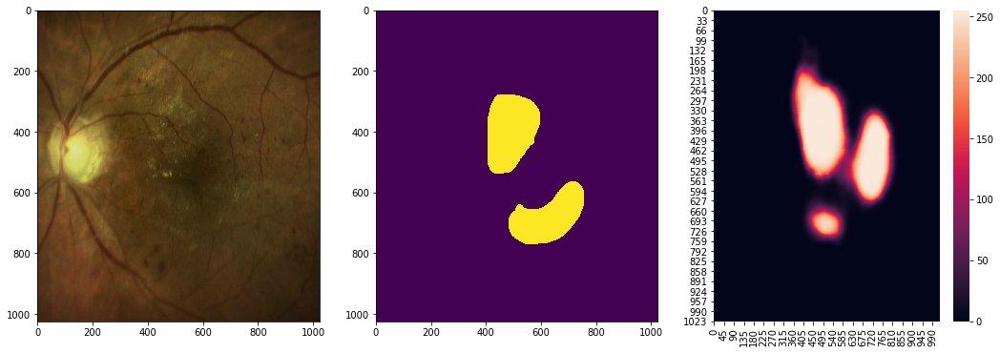

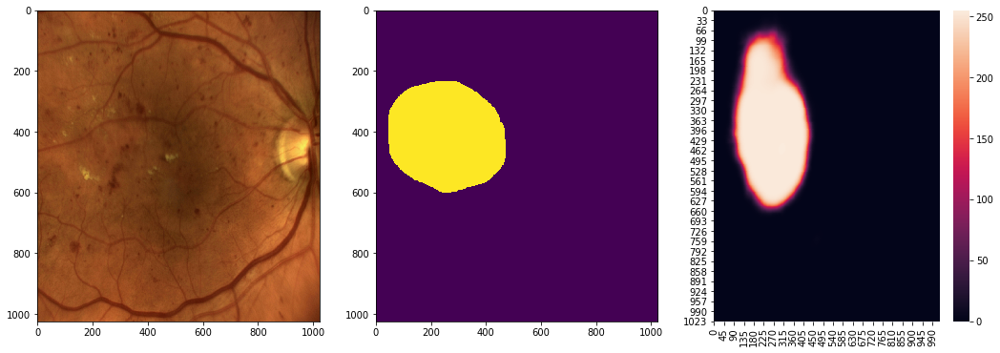

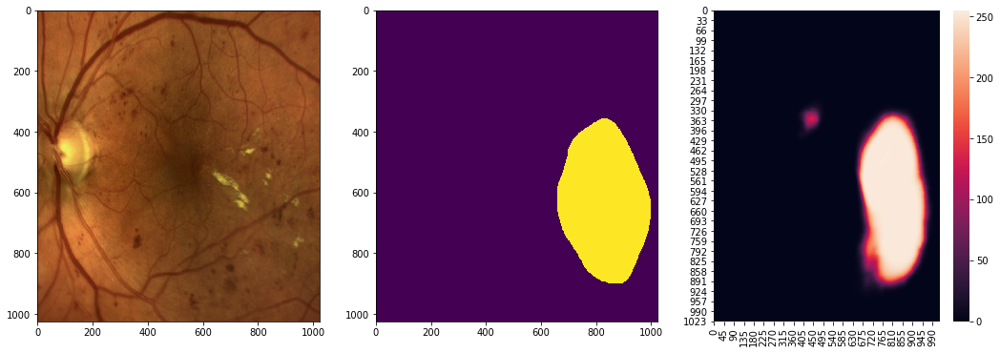

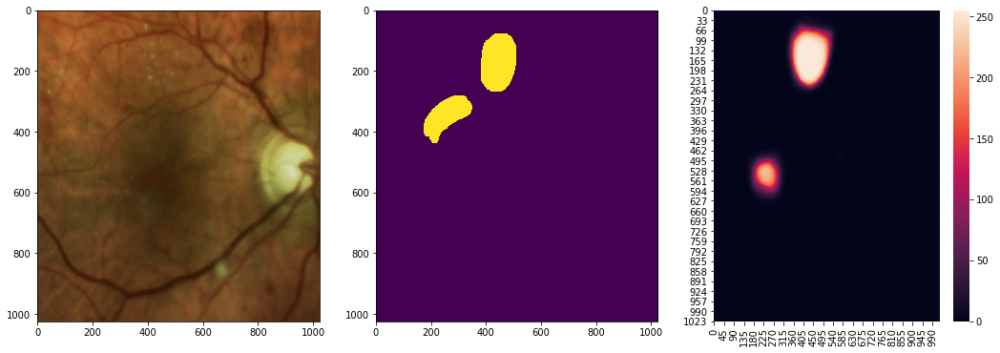

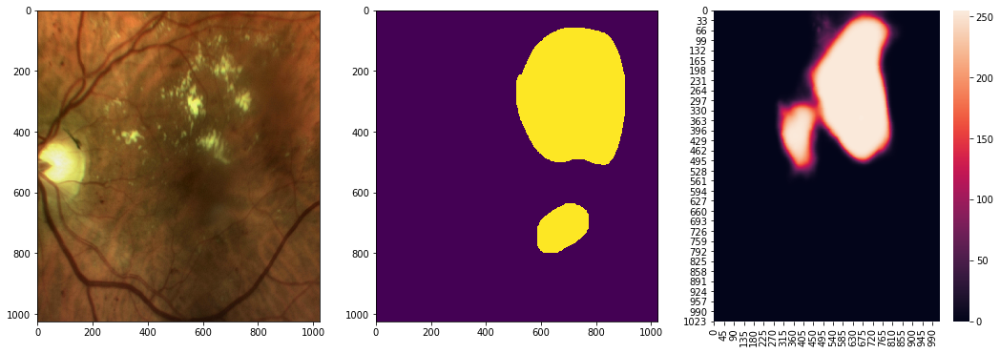

...

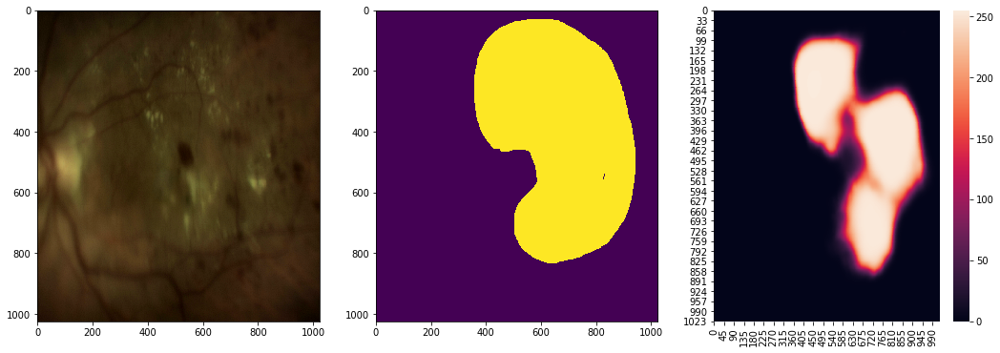

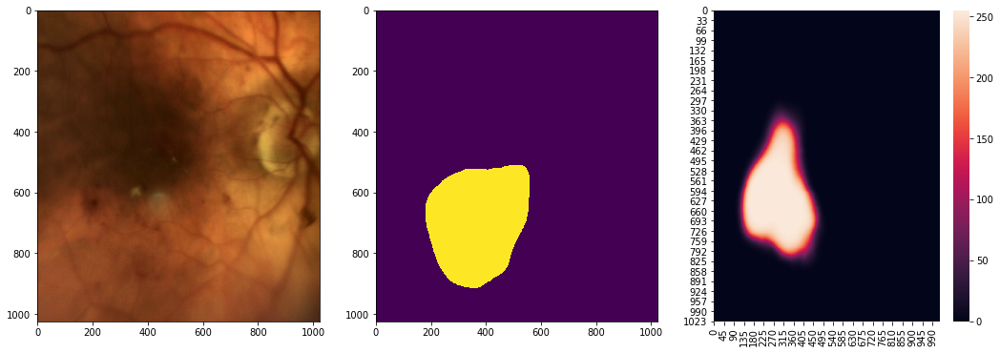

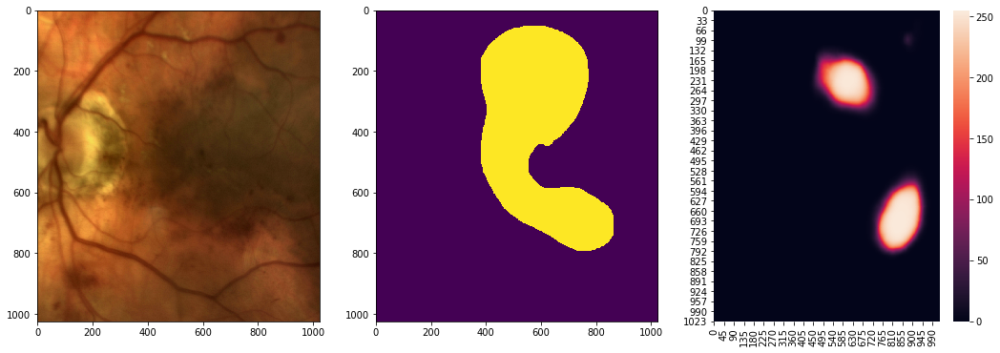

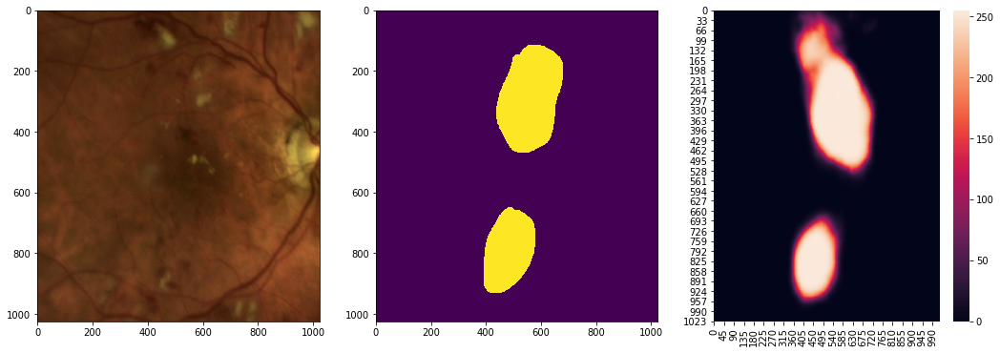

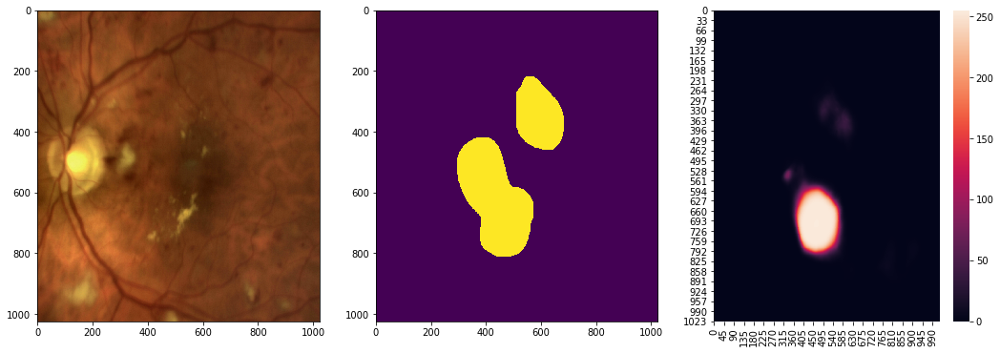

['img_15_', 'img_15_1', 'img_16_', 'img_16_1', 'img_17_', 'img_18_', 'img_19_', 'img_1_', 'img_1_1', 'img_20_', 'img_20_1']


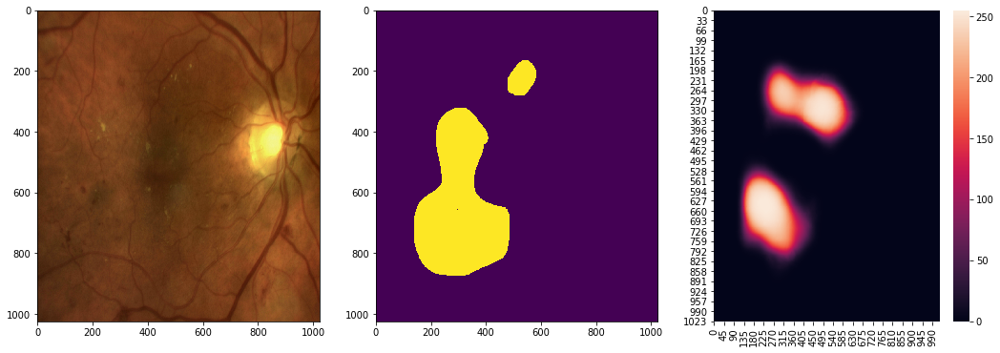

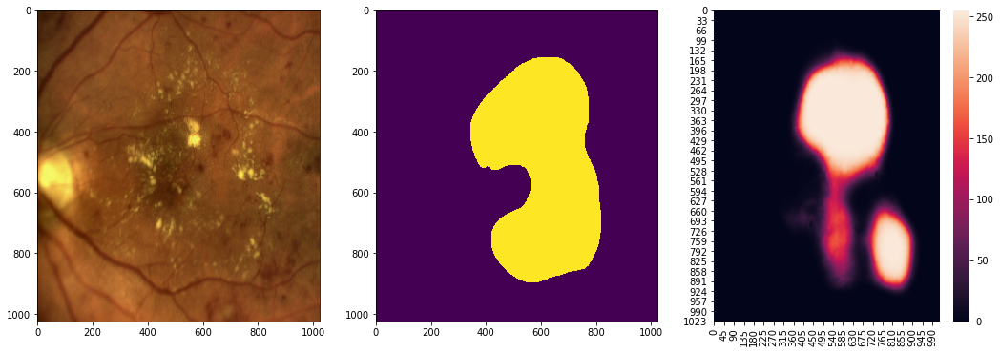

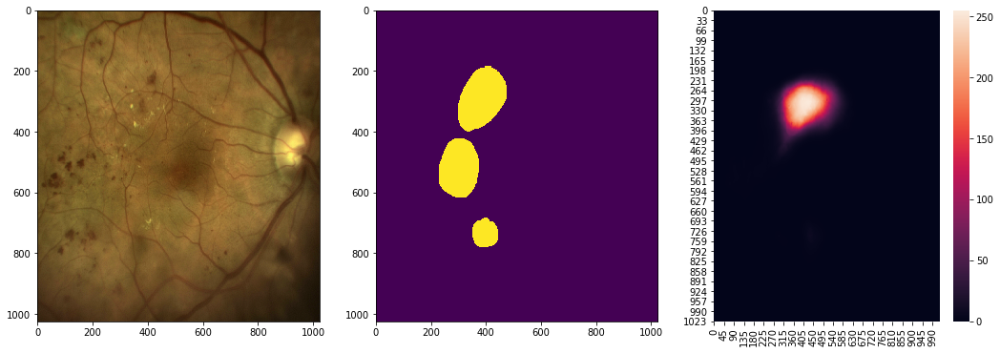

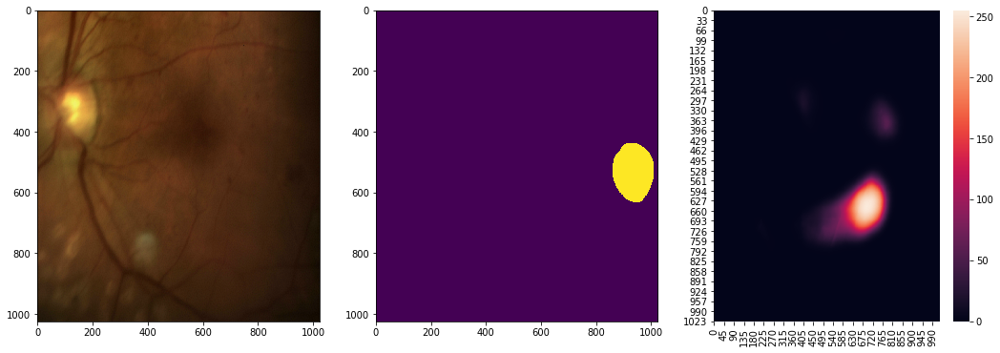

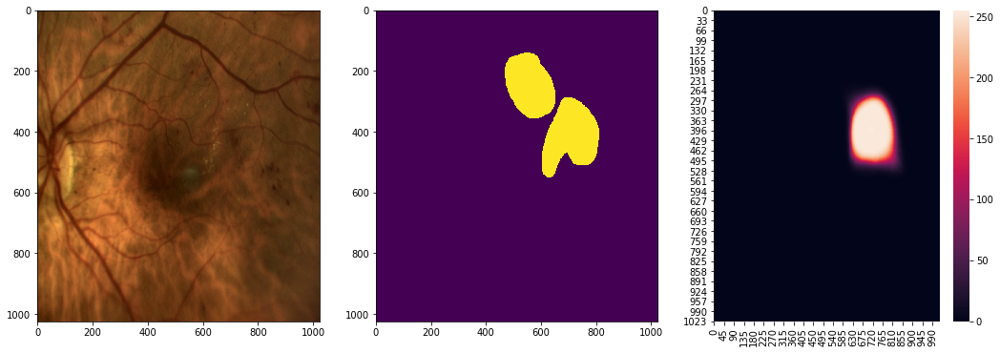

...

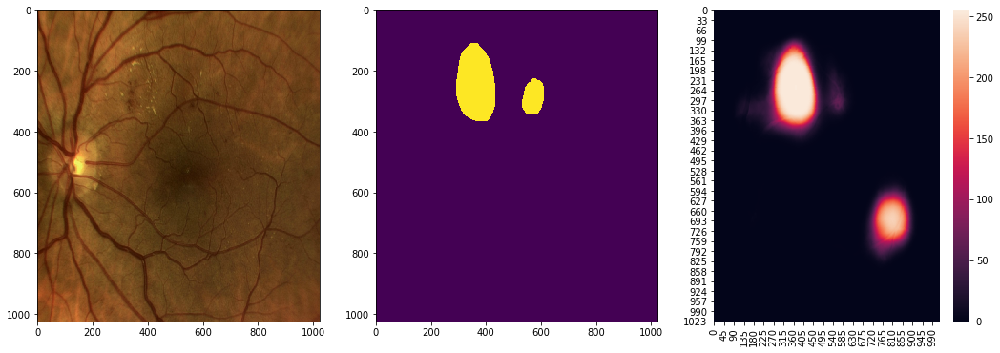

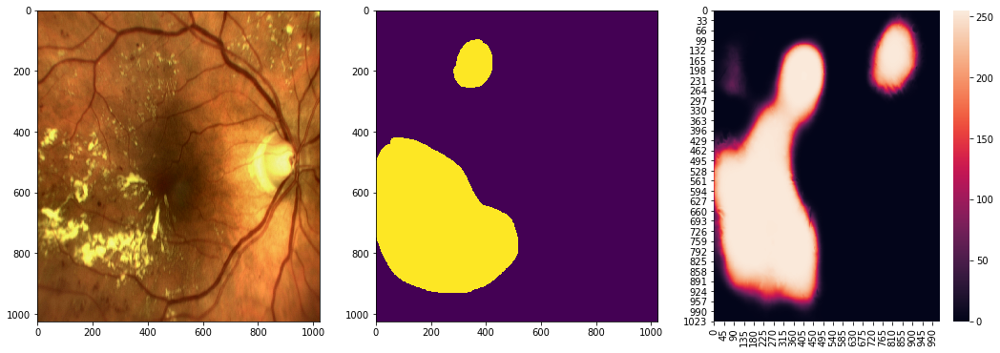

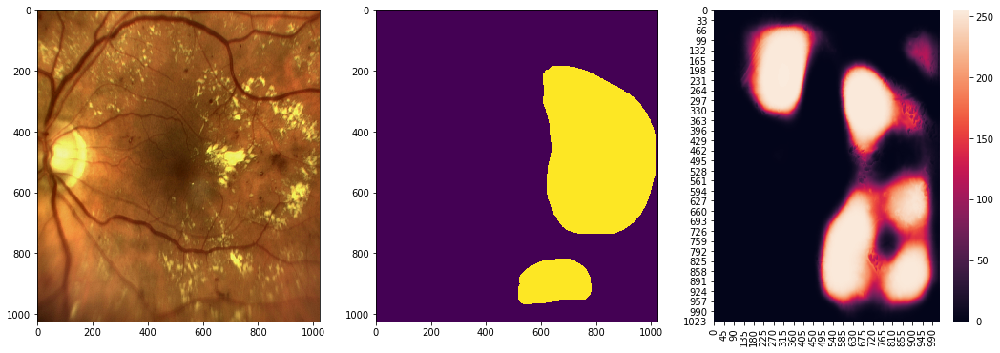

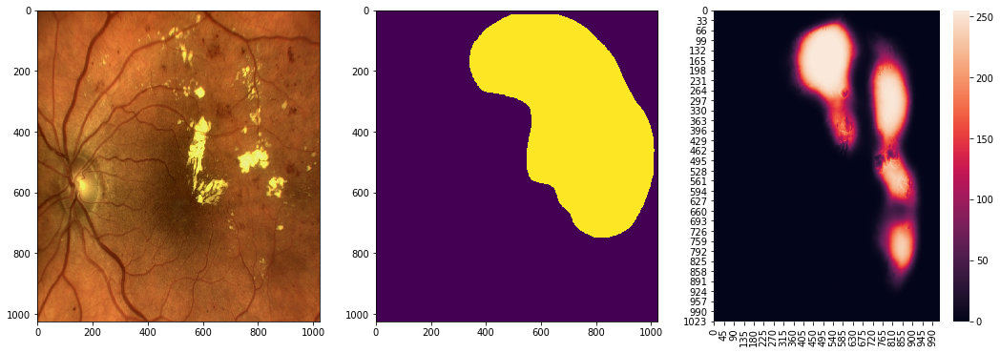

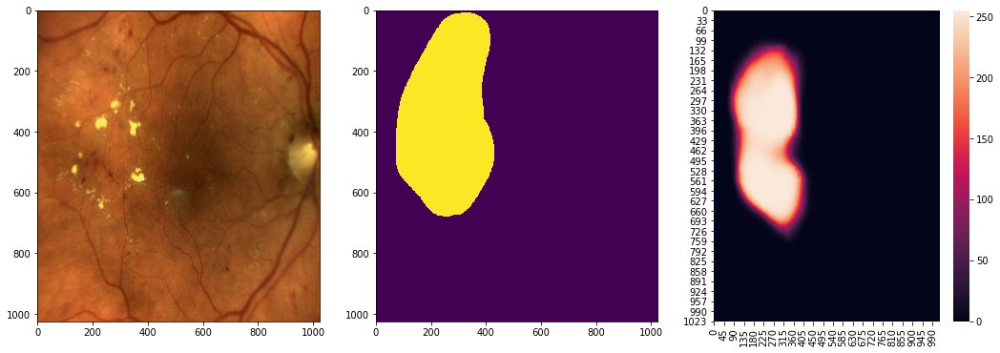

['img_21_', 'img_22_', 'img_22_1', 'img_23_', 'img_23_1', 'img_24_', 'img_24_1', 'img_25_', 'img_26_', 'img_27_', 'img_28_']


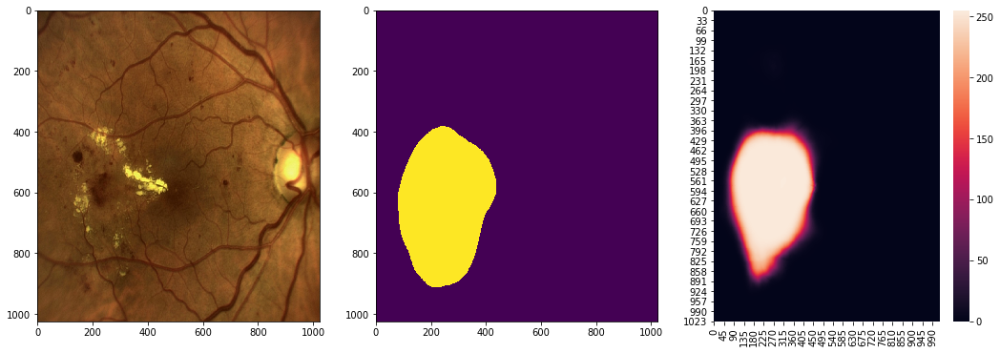

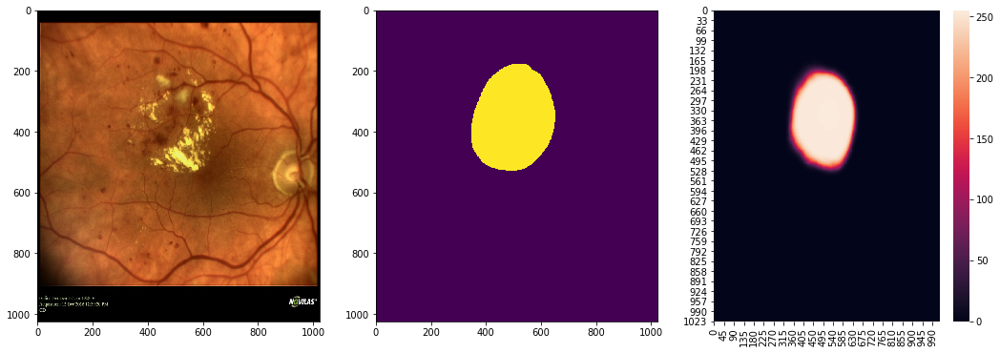

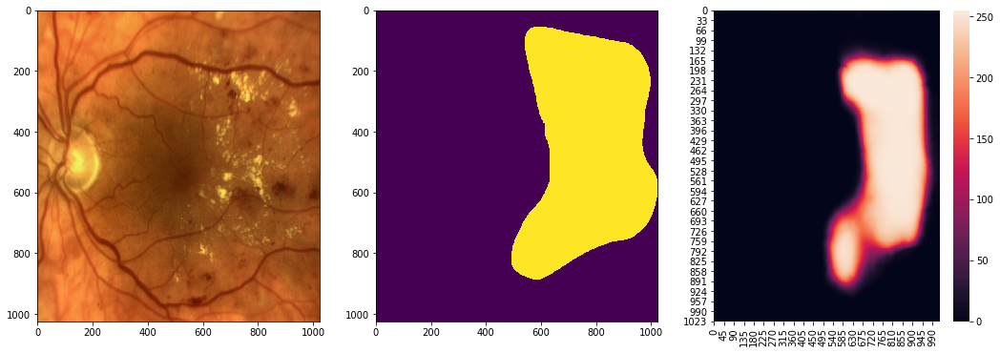

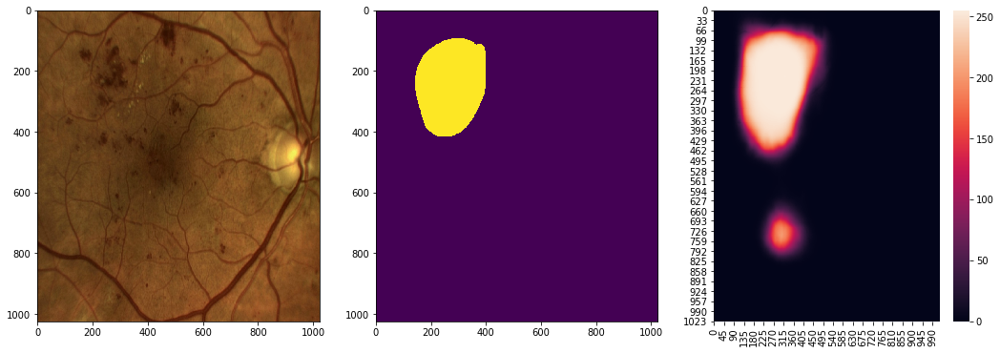

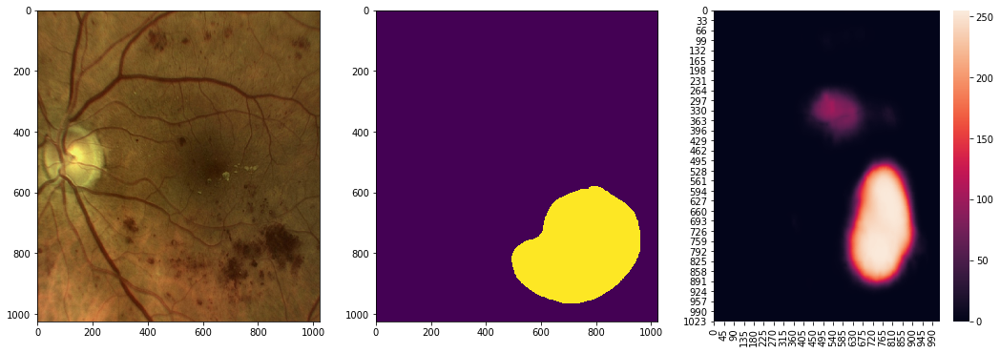

...

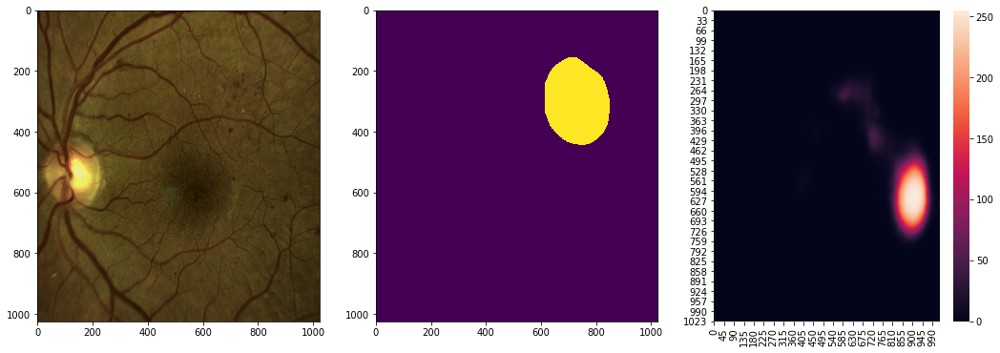

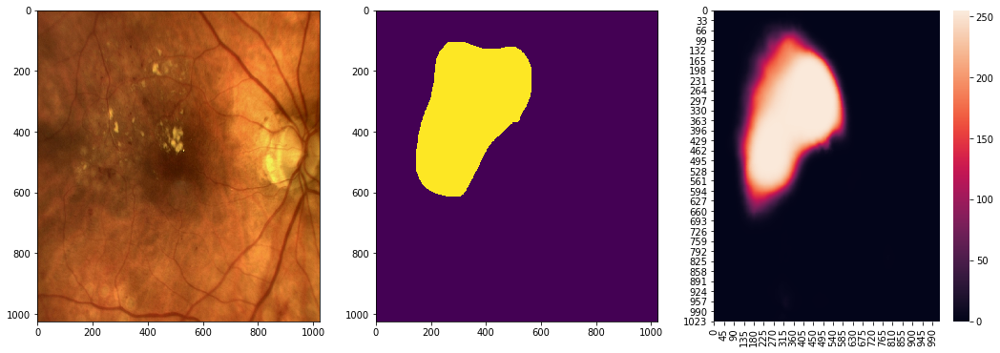

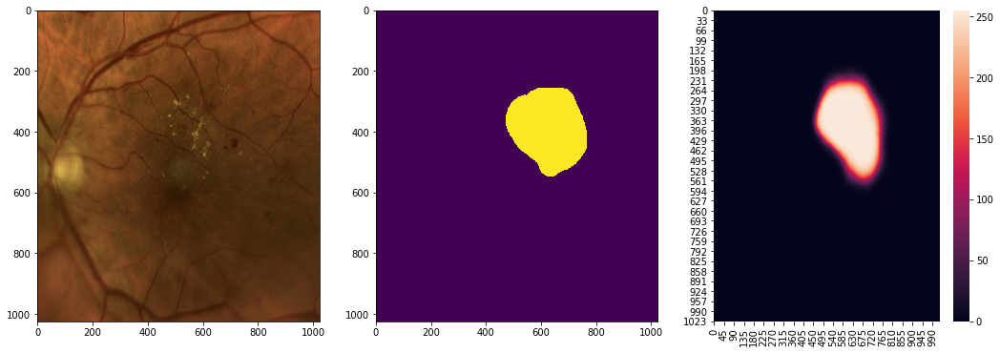

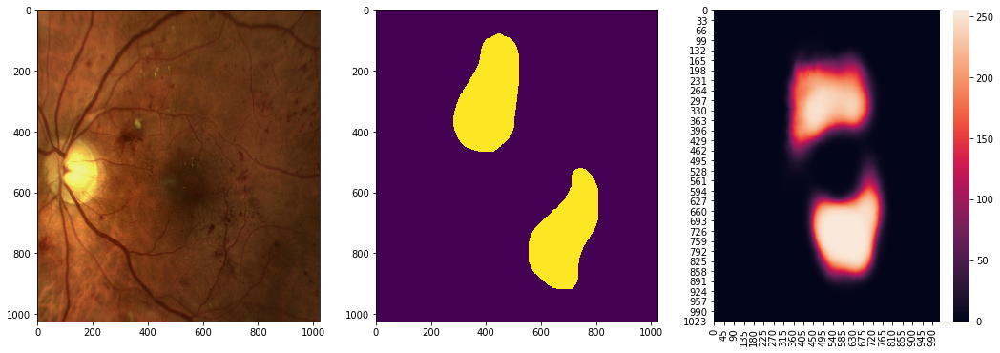

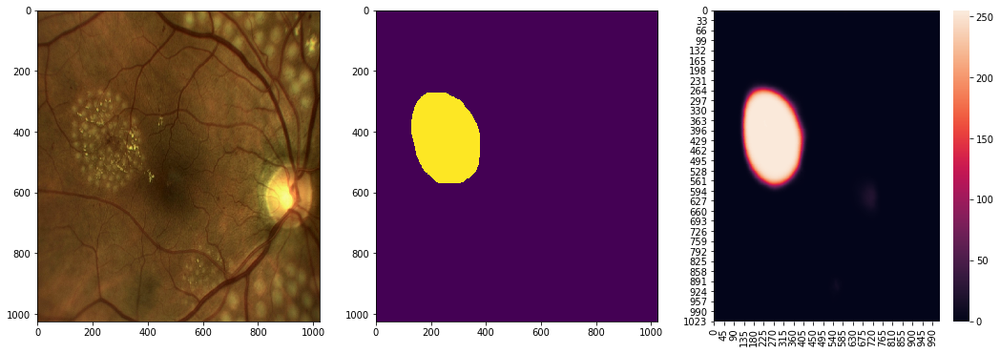

['img_29_', 'img_29_1', 'img_2_', 'img_3', 'img_30_', 'img_30_1', 'img_31_', 'img_31_1', 'img_32_', 'img_32_1', 'img_33_']


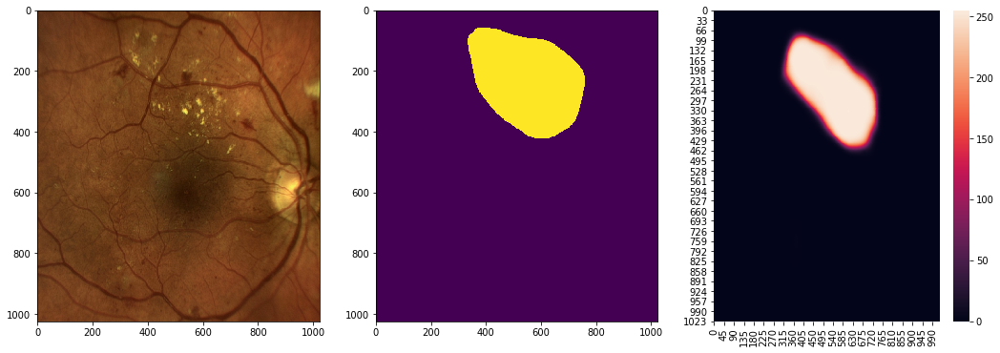

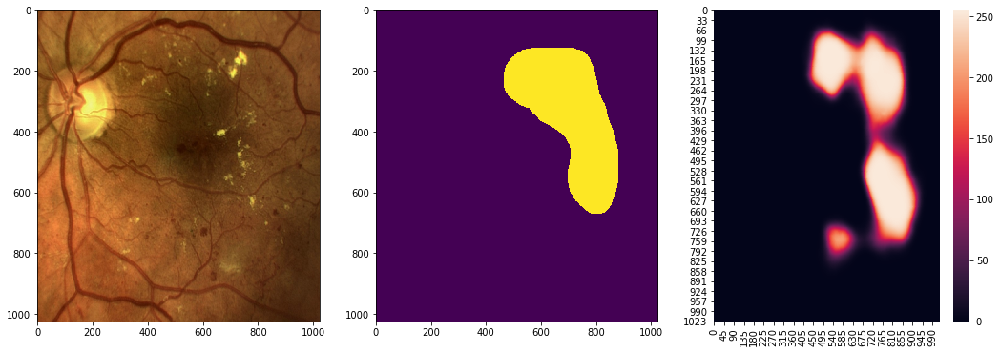

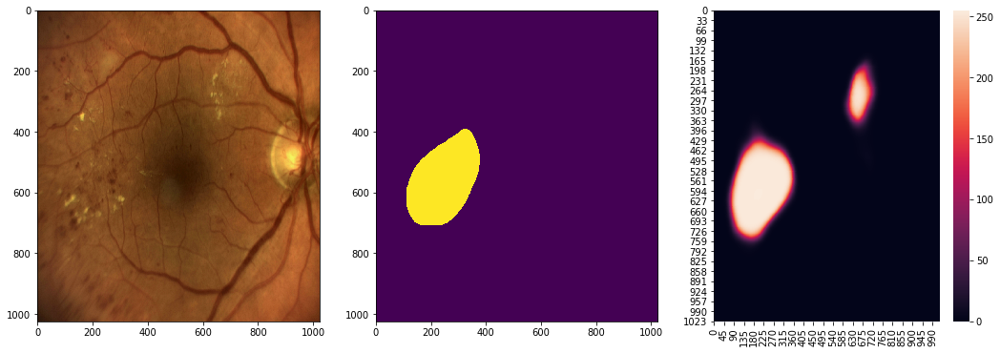

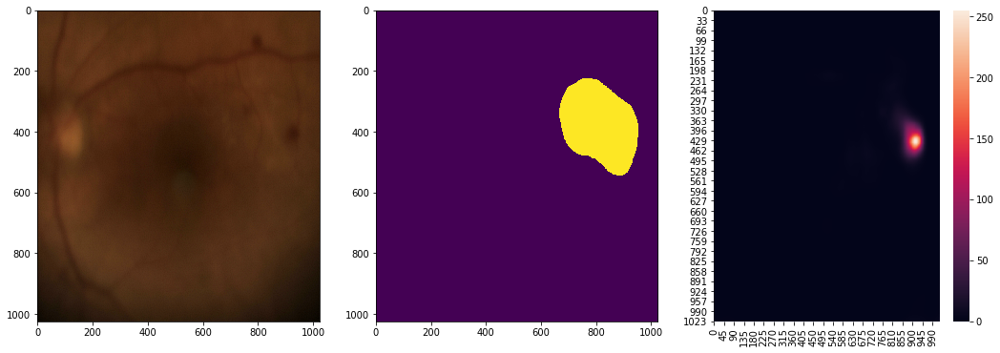

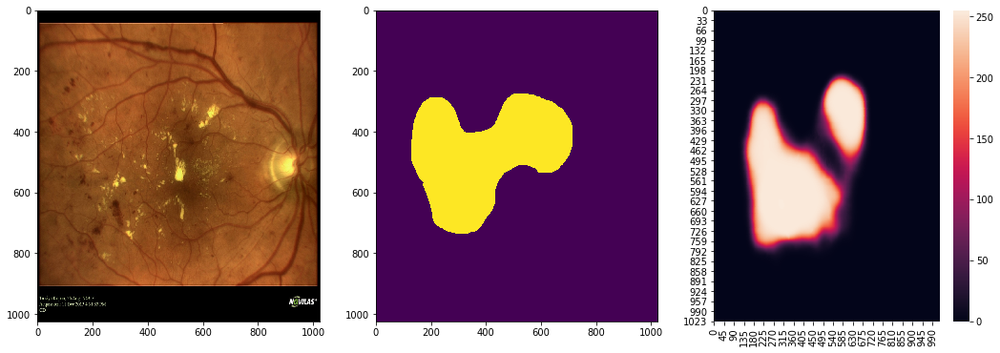

...

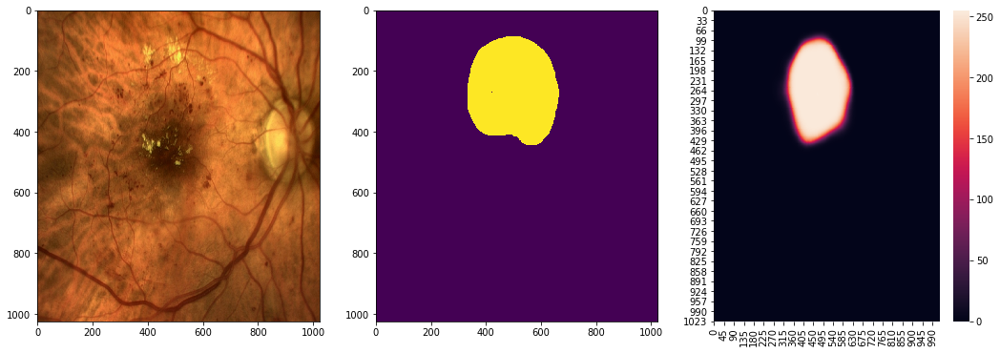

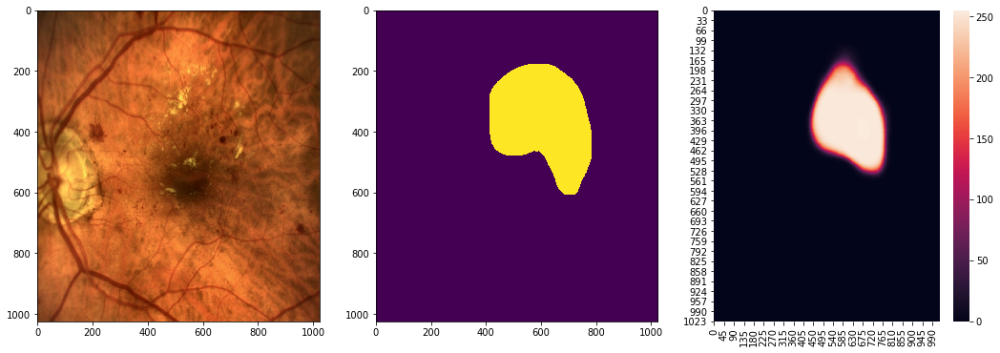

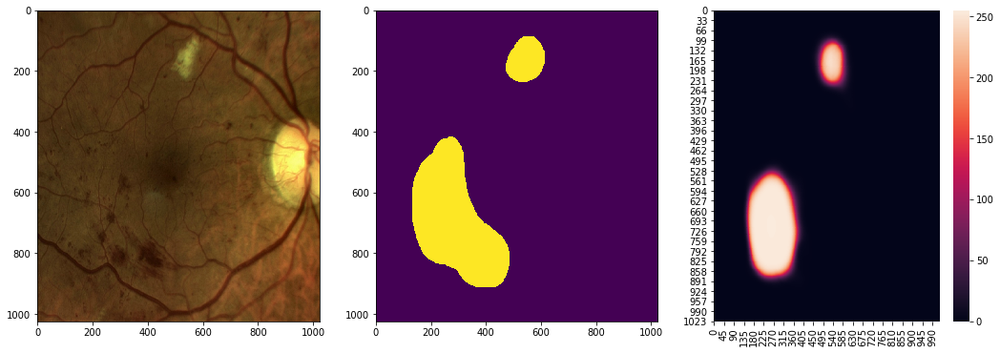

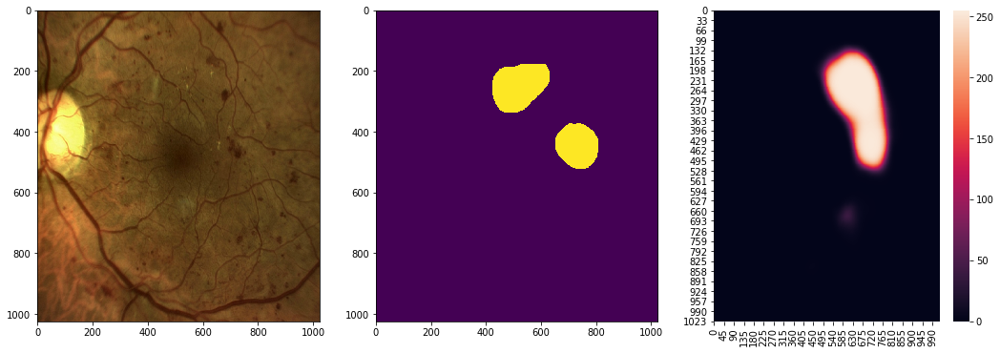

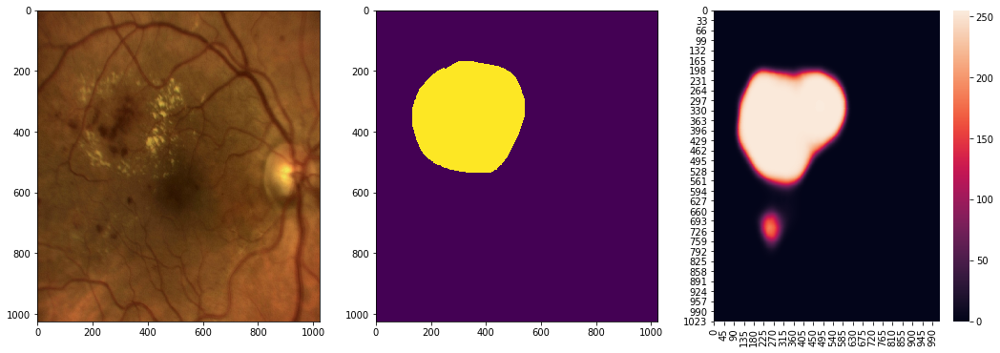

['img_33_1', 'img_34_', 'img_34_1', 'img_35_', 'img_36_', 'img_36_1', 'img_37_', 'img_37_1', 'img_38_', 'img_38_1', 'img_39_']


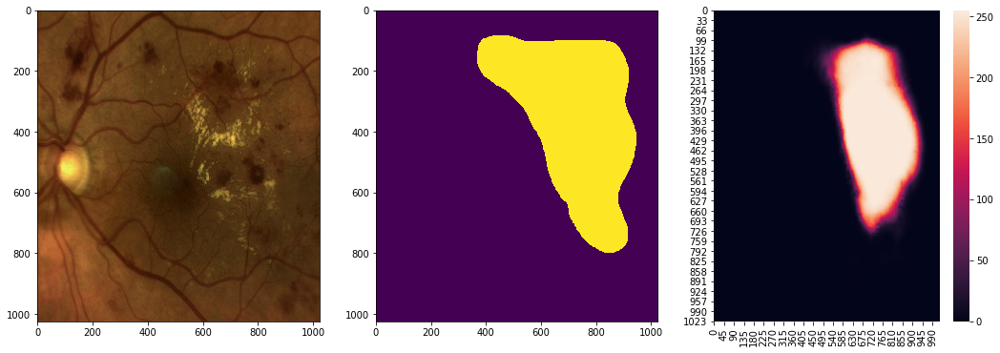

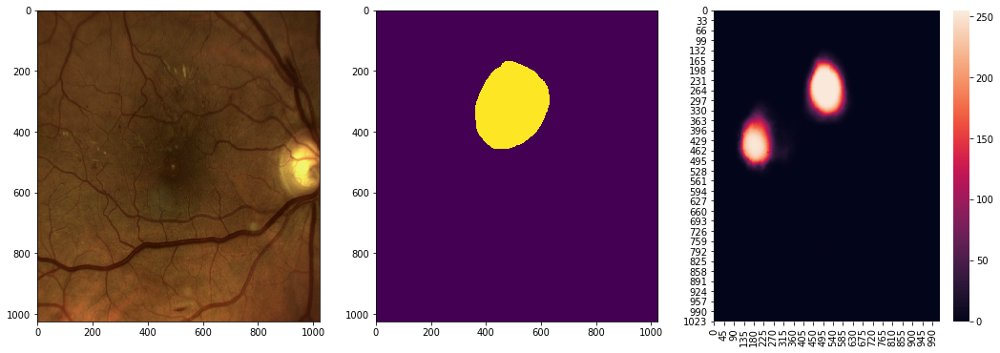

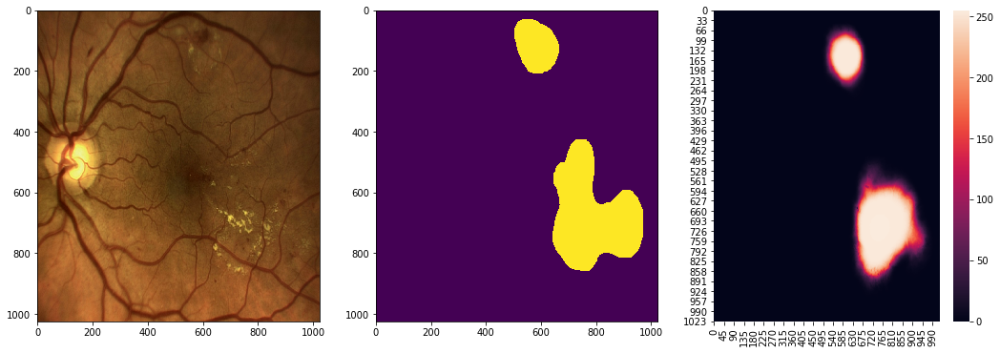

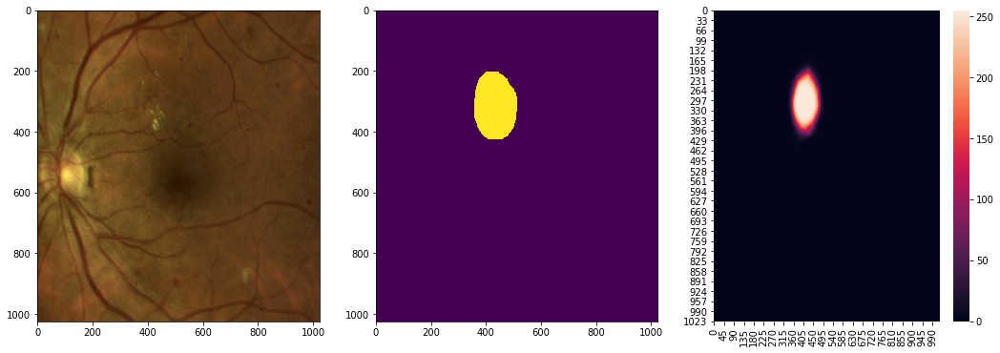

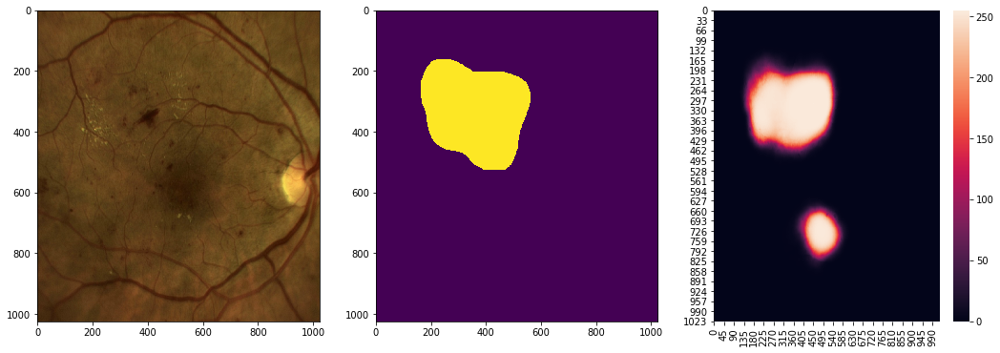

...

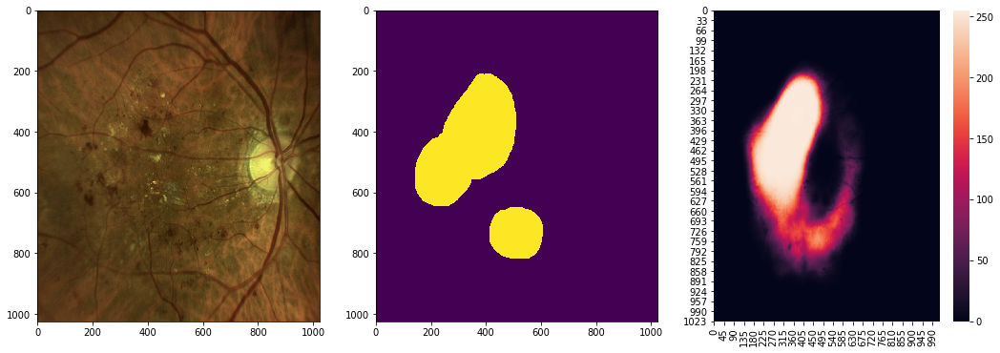

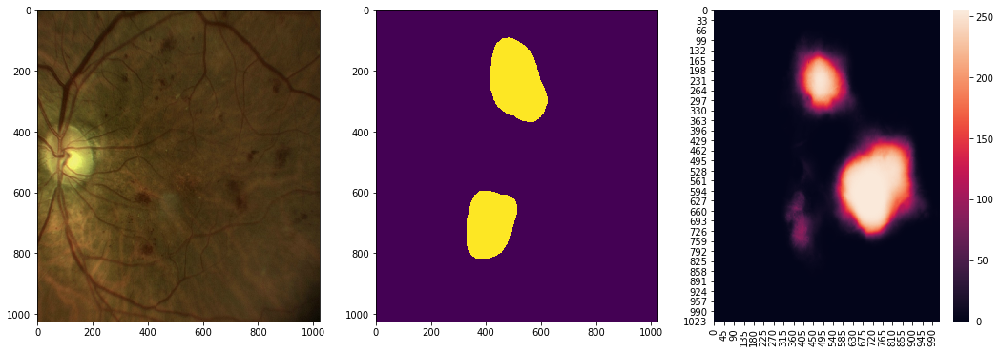

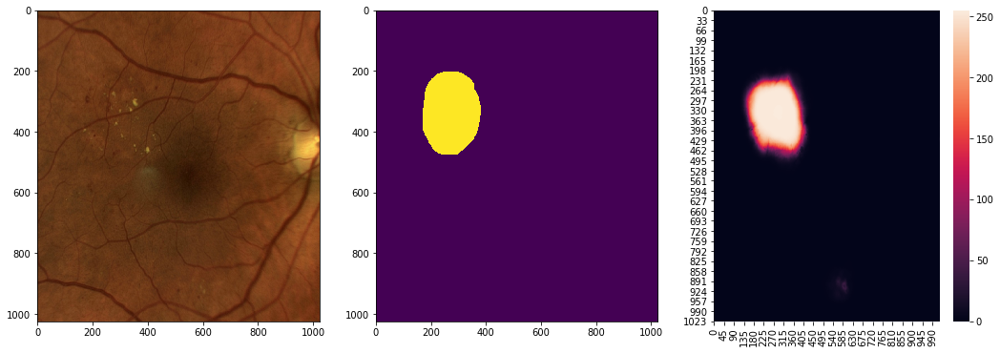

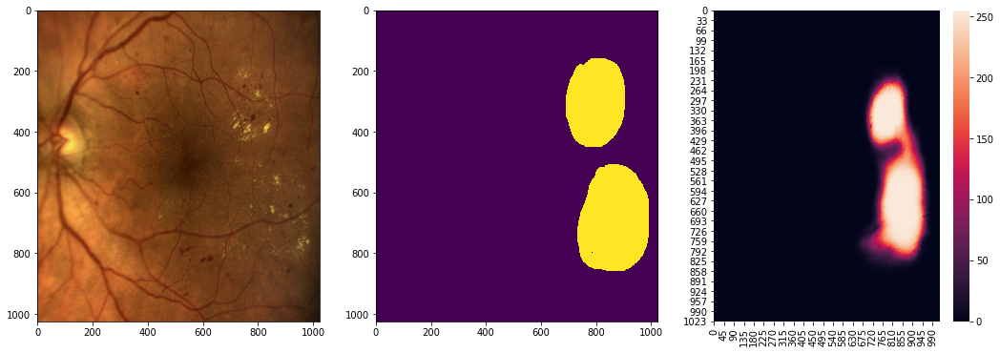

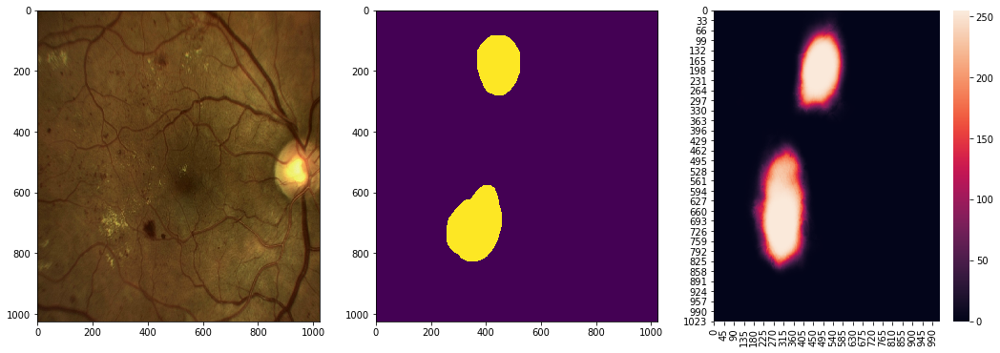

['img_39_1', 'img_40_', 'img_41_', 'img_42_', 'img_42_1', 'img_43_', 'img_44_', 'img_45_', 'img_46_', 'img_46_1', 'img_47_']


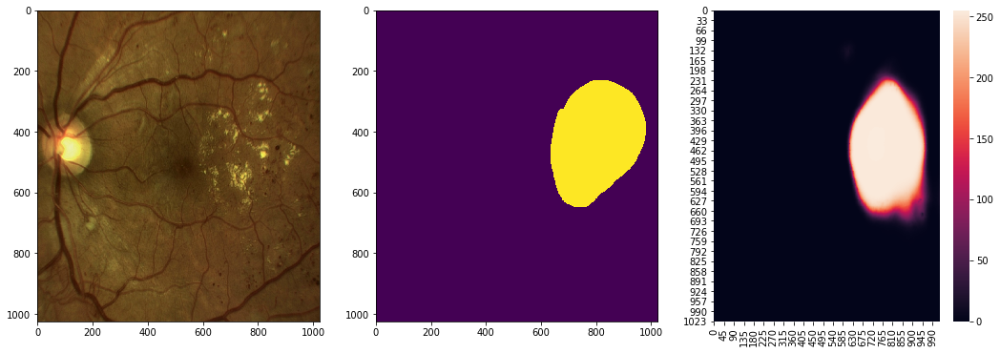

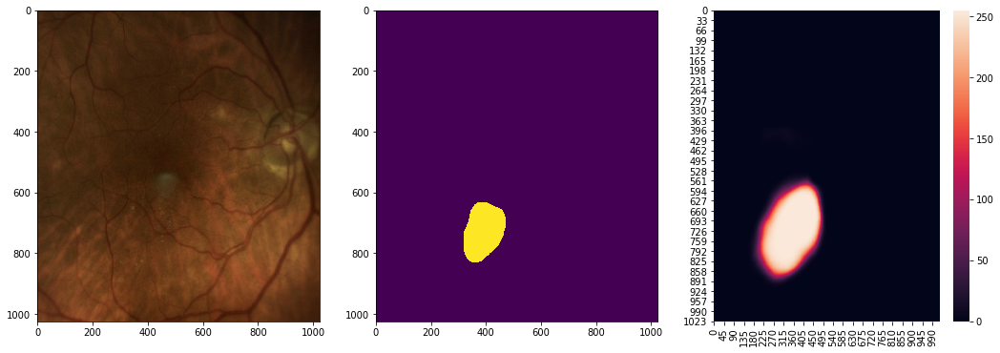

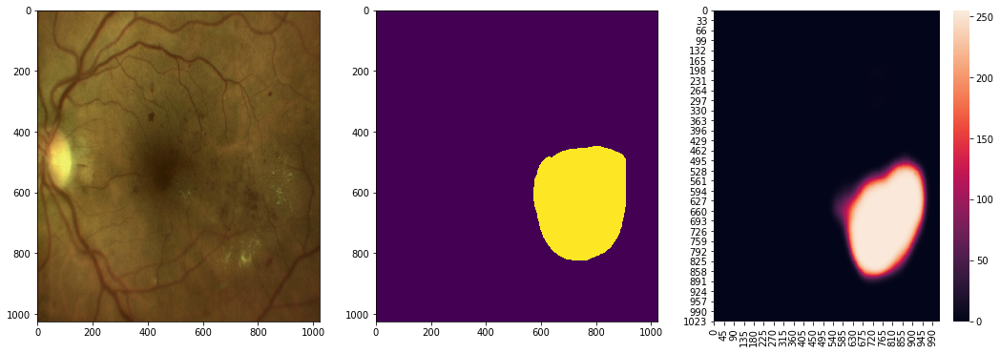

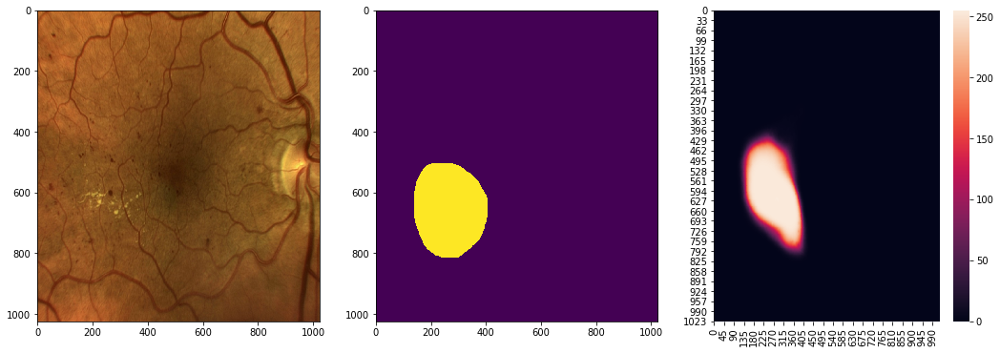

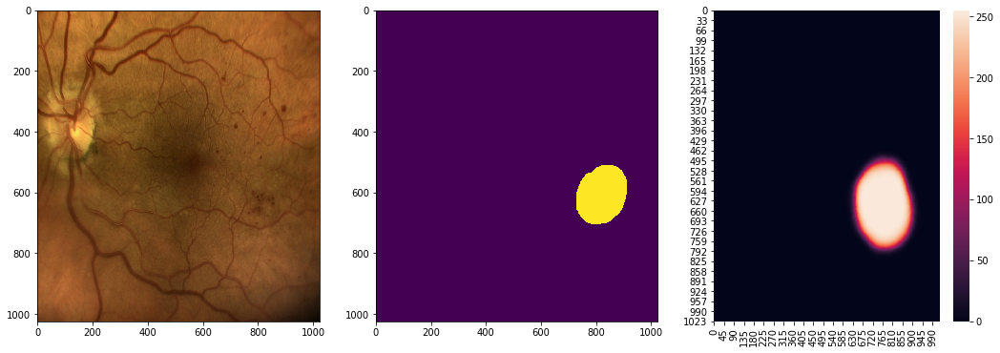

...

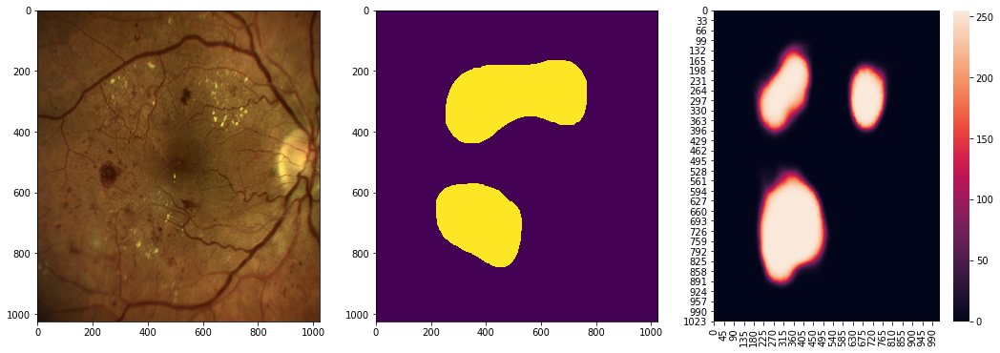

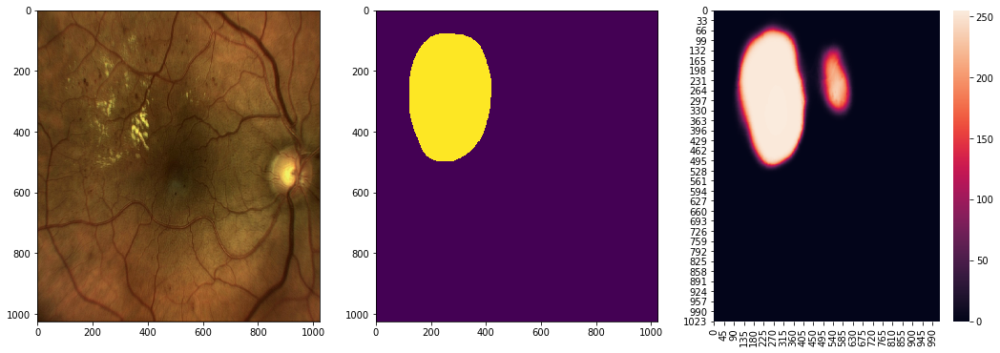

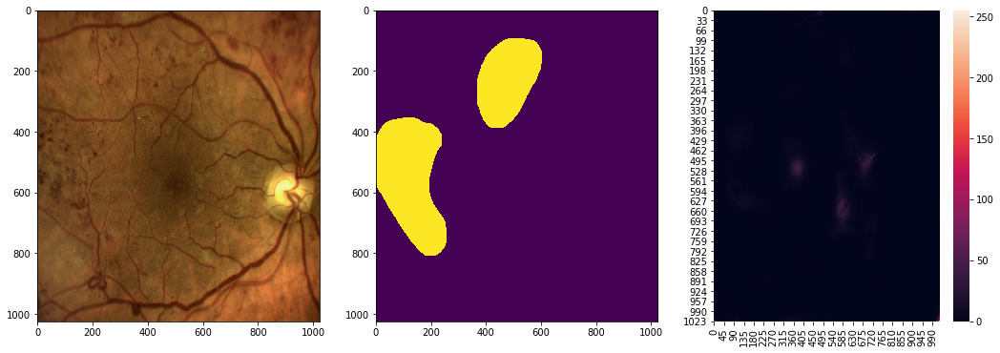

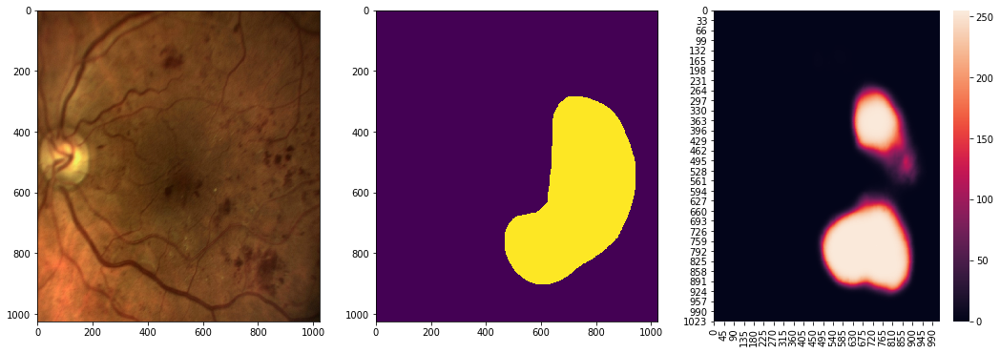

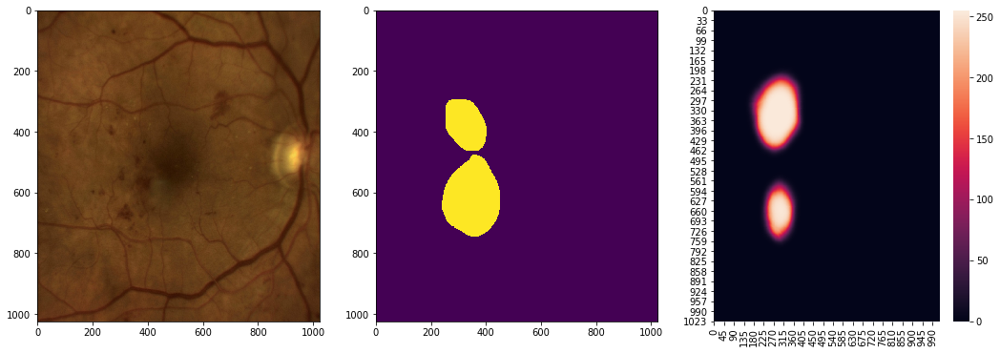

['img_47_1', 'img_48_', 'img_48_1', 'img_49_', 'img_4_', 'img_4_1', 'img_5_', 'img_5_1', 'img_6_', 'img_6_1', 'img_7_', 'img_7_1', 'img_8_', 'img_8_1', 'img_9_', 'img_9_1']


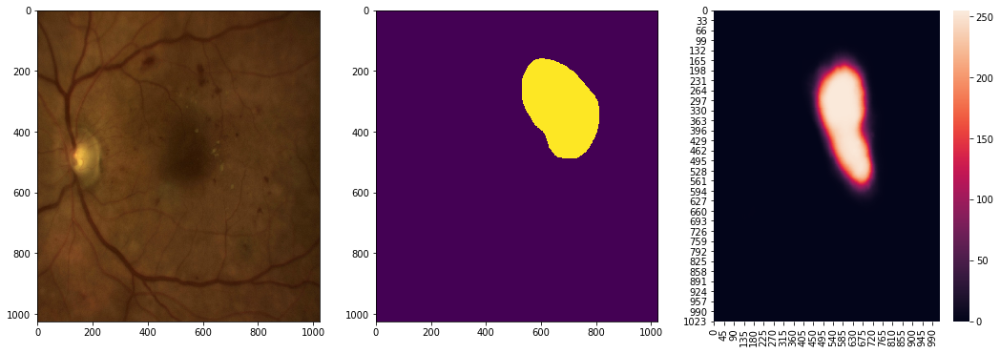

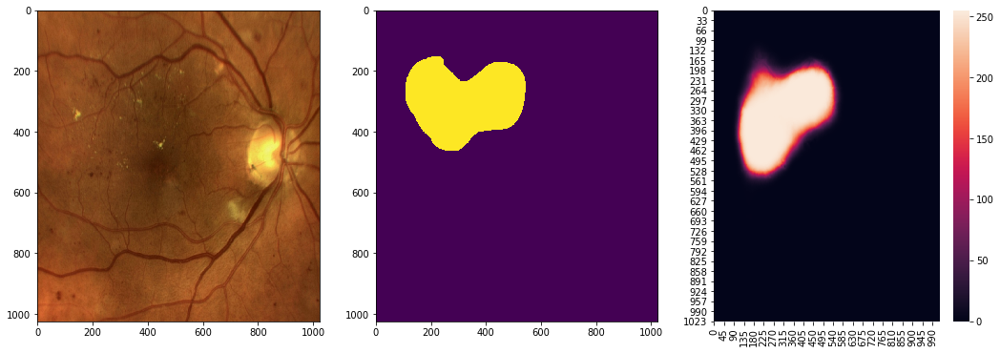

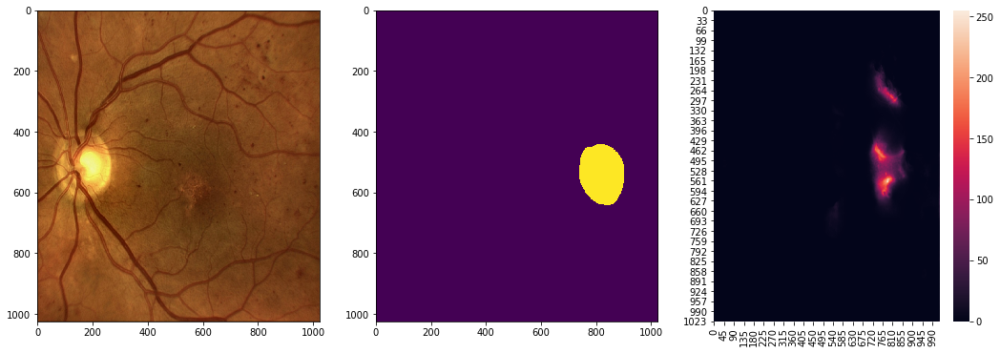

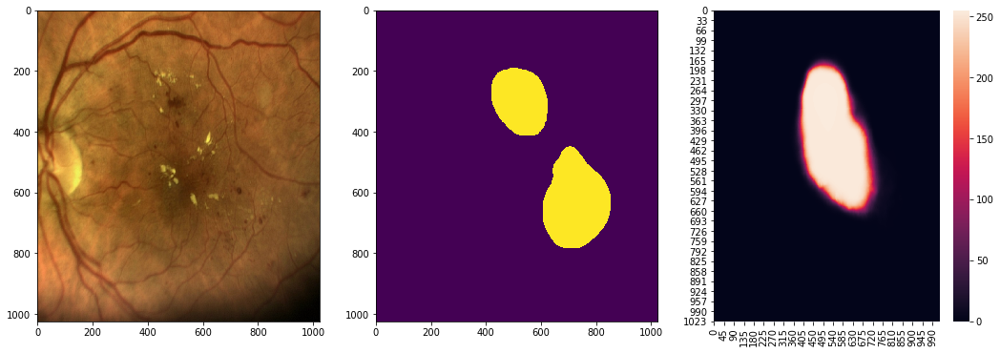

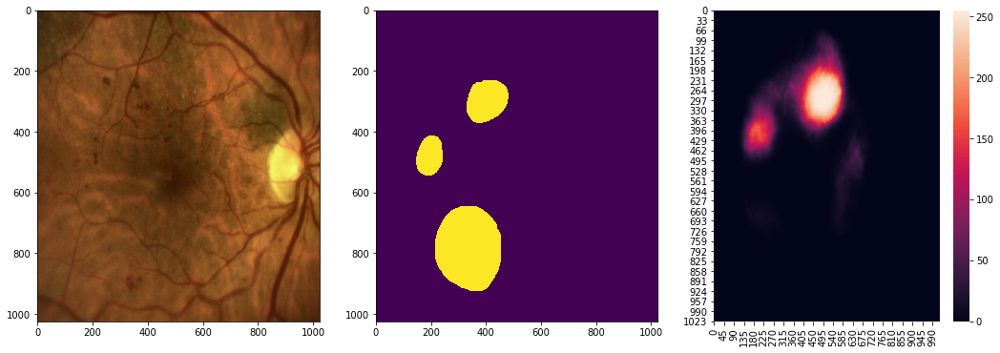

...

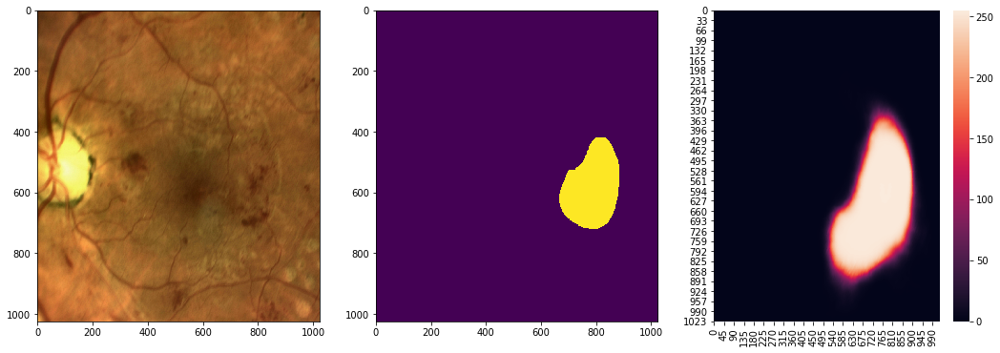

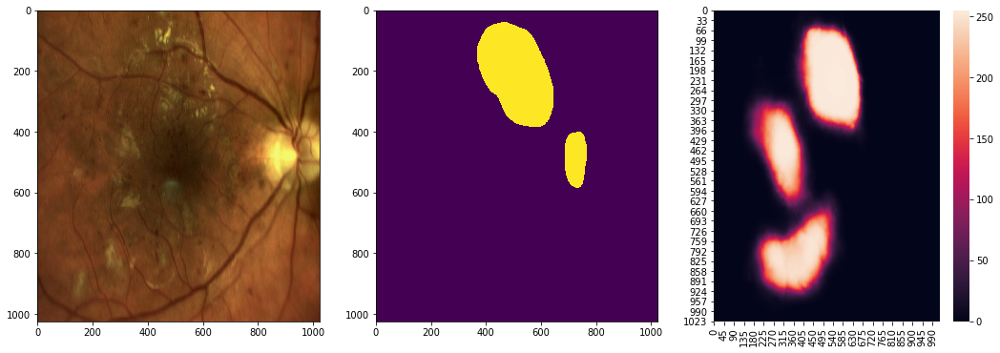

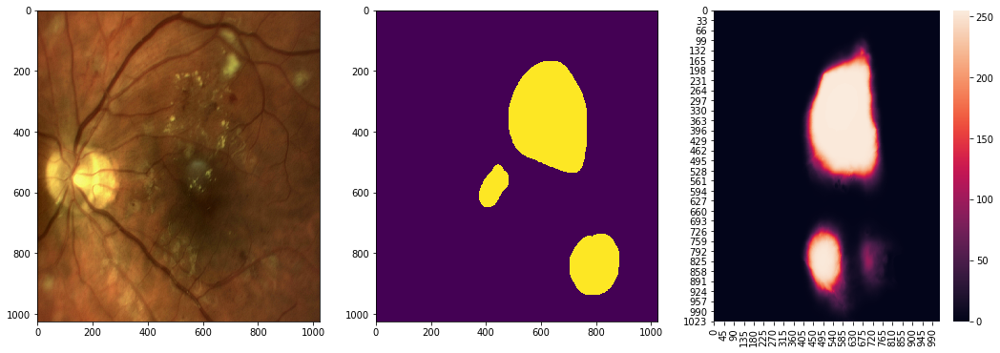

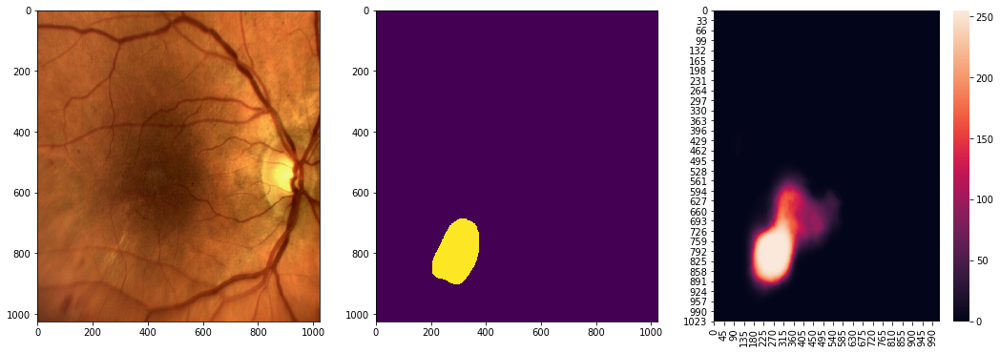

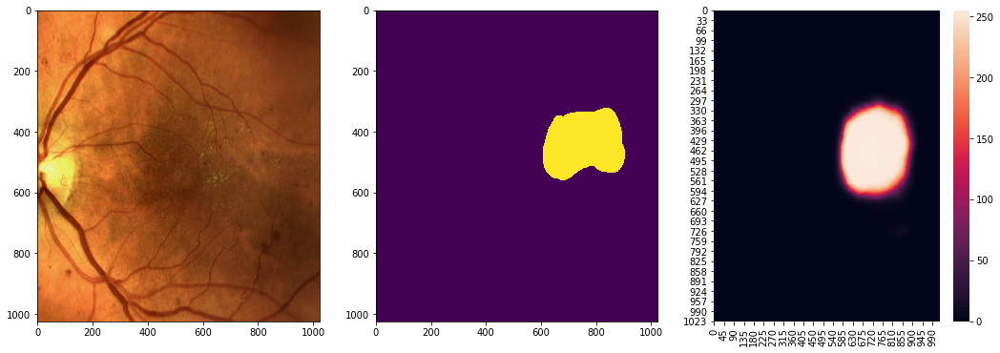

In [133]:
all_images = []
all_masks = []
counter = 0
for i in range(1, 8):
    ps, xs, ys, base_names = get_data(f'Test#3_Pytorch_U2Net/{i}-fold_aug_2_default_parameters/test')
    print(base_names)
    for x, y, p, name in zip(xs, ys, ps, base_names):
        fig, ax = plt.subplots(1, 3, figsize=(18, 6))
        ax[0].imshow(x,  aspect="auto")
        ax[1].imshow(y, aspect="auto")
        sns.heatmap(cv2.cvtColor(p, cv2.COLOR_BGR2GRAY), ax=ax[2], square=False)
        plt.show()
        fig.savefig(f'Test#3_Pytorch_U2Net/answers/{name}.png')
        plt.clf()
        plt.cla()
        plt.close()
        counter += 1

In [105]:
import json

In [114]:
with open('Test#3_Pytorch_U2Net/dices.json') as f:
    j = json.load(f)

In [115]:
new_dict = {'props': {}, 'values': {}}

In [116]:
dices = []
for k, v in j.items():
    dices.append(v)
avg_dice = np.mean(dices)

In [117]:
j['avg_dice'] = avg_dice

In [118]:
for i, (k, v) in enumerate(j.items()):
    new_dict['props'][f'{i}'] = k
    new_dict['values'][f'{i}'] = v

In [121]:
with open('Test#3_Pytorch_U2Net/table_dices.json', 'w') as f:
    json.dump(new_dict, f)

In [124]:
import pandas as pd
df = pd.read_json(r'Test#3_Pytorch_U2Net/table_dices.json')

In [125]:
df.to_csv('dices.csv')